<a href="https://colab.research.google.com/github/kobejean/lar-lab-notebooks/blob/main/notebooks/iimoriyama_localization_custom_pnp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

In [1]:
import os

In [2]:
if not os.path.exists("repo"):
  !git clone https://github.com/kobejean/lar-lab-notebooks.git repo


Cloning into 'repo'...
remote: Enumerating objects: 80, done.
remote: Counting objects: 100% (80/80), done.
remote: Compressing objects: 100% (64/64), done.
remote: Total 80 (delta 12), reused 68 (delta 11), pack-reused 0
Unpacking objects: 100% (80/80), done.


In [3]:
import json
import cv2
import numpy as np
import base64

class LARAnchor():
  
  def __init__(self, obj):
    self.id = obj["id"]
    self.transform = np.asarray(obj["transform"]).reshape((4,4)).transpose()
    

class LARLandmark():

  def __init__(self, obj):
    self.id = obj["id"]
    desc_bytes = base64.b64decode(obj["desc"])
    self.desc = np.asarray(list(desc_bytes), dtype=np.uint8)
    self.position = np.asarray(obj["position"], dtype=np.float64)

  @staticmethod
  def concatDescriptions(landmarks):
    return np.stack([landmark.desc for landmark in landmarks])

class LARMap():
  anchors = {}
  landmarks = []
  def __init__(self, obj):
    for id, anchor_obj in obj["anchors"]:
      self.anchors[id] = LARAnchor(anchor_obj)
      
    for landmark_obj in obj["landmarks"]:
      landmark = LARLandmark(landmark_obj)
      self.landmarks.append(landmark)

  @staticmethod
  def read(path):
    f = open(path)
    obj = json.loads(f.read())
    return LARMap(obj)


class LARFrame():
  def __init__(self, obj):
    self.id = obj["id"]
    self.intrinsics = np.asarray(obj["intrinsics"]).reshape((3,3)).transpose()
    self.extrinsics = np.asarray(obj["extrinsics"]).reshape((4,4)).transpose()

  
  @staticmethod
  def read(path):
    f = open(path)
    obj = json.loads(f.read())
    return [LARFrame(frame_obj) for frame_obj in obj]

# Read Pre-processed Map

In [4]:
map = LARMap.read("/content/repo/data/iimoriyama/cloudy_evening/map.json")
map_desc = LARLandmark.concatDescriptions(map.landmarks)
print(map_desc)

[[ 67 141 216 ... 254 255   3]
 [ 64 237   3 ...   1 160  53]
 [ 11 232 159 ...   6   0  55]
 ...
 [224 247   1 ... 184 255  10]
 [ 33 238  13 ... 121 255  33]
 [161  55  12 ... 249 255  11]]


# Read a Test Image and Camera Parameters

In [47]:
# Load files
img_id = 8
data_directory = "/content/repo/data/iimoriyama/cloudy_afternoon"
data_directory = "/content/repo/data/iimoriyama/cloudy_evening"
frames = LARFrame.read(f"{data_directory}/frames.json")

def load_img(img_id):
  return cv2.imread(f"{data_directory}/{img_id:08d}_image.jpeg")


img = load_img(img_id)
frame = frames[img_id]












# Feature Extraction and Matching

In [48]:
# Exctract features
akaze = cv2.AKAZE_create()
bf = cv2.BFMatcher(cv2.DescriptorMatcher_BRUTEFORCE_HAMMING)

def feature_extract_and_match(img, map_desc):
  kpts, desc = akaze.detectAndCompute(img, None)

  # Match features
  matches = bf.knnMatch(desc, map_desc, k=2)

  # Ratio test
  ratio = 0.7
  good = []
  for m, n in matches:
    if m.distance < ratio * n.distance:
      good.append(m)
      
  print(f"{len(good)} inliers found")
  return kpts, good

kpts, matches = feature_extract_and_match(img, map_desc)


223 inliers found


# PnP (Perspective-n-Point)

In [56]:

def to_homogeneous(x):
  return np.concatenate([x, [1]])


def to_unity(x):
  return x / np.linalg.norm(x)

def alignment_rotation(v):
  Ra = np.array([[ v[1],  v[0],     0],
                 [-v[0],  v[1], -v[2]],
                 [    0,  v[2],  v[1]]])
  Ra[:,0] = to_unity(Ra[:,0])
  Ra[:,1] = to_unity(Ra[:,1])
  Ra[:,2] = to_unity(Ra[:,2])
  return Ra

def custom_p2p(x1, x2, y1, y2, v, v2, frame):

  Ra = alignment_rotation(v)
  Ra2 = alignment_rotation(v2)

  # flip y and z axis
  Ra[1:3] = -Ra[1:3]
  Ra2[:,1:3] = -Ra2[:,1:3]
  
  RaInv = np.linalg.inv(Ra)
  Ra2Inv = np.linalg.inv(Ra2)
  # print("Ra", Ra)
  # print("Ra2", Ra2)
  # v3 = np.array(v)
  # v3[1:3] = -v3[1:3]
  # v4 = np.array(v2)
  # print("RaInv v3", np.matmul(RaInv, v3))
  # print("Ra2 v3", np.matmul(Ra2, v3))
  # print("Ra.T v3", np.matmul(Ra.T, v3))
  # print("Ra v4", np.matmul(Ra, v4))
  # print("Ra2Inv v4", np.matmul(Ra2Inv, v4))
  # print("Ra2.T v4", np.matmul(Ra2.T, v4))
  # print("RaInv", RaInv)
  # print("Ra.T Ra", np.matmul(Ra.T, Ra))
  # print("RaInv Ra", np.matmul(RaInv, Ra))
  v = np.array([0.,1.,0.], dtype=np.float32)
  # v = np.array(v2)

  K = np.array(frame.intrinsics)
  Kinv = np.linalg.inv(K)

  # homogenous pixel coordinates
  y1 = to_homogeneous(y1)
  y2 = to_homogeneous(y2)
  # camera space coordinates using intrinsics matrix
  y1 = np.matmul(Kinv, y1)
  y2 = np.matmul(Kinv, y2)
  # align vertical vector
  # y1 = np.matmul(Ra.T, y1)
  # y2 = np.matmul(Ra.T, y2)
  # y1 = np.matmul(Ra2, y1)
  # y2 = np.matmul(Ra2, y2)
  y1 = np.matmul(RaInv, y1)
  y2 = np.matmul(RaInv, y2)
  # normalize to unit length
  y1 /= np.linalg.norm(y1)
  y2 /= np.linalg.norm(y2)


  dx = x1-x2

  m = np.dot(dx, v) / np.dot(y1, v)
  n = np.dot(y2, v) / np.dot(y1, v)

  # print("n", n)
  # print("m", m)

  k = n*y1 - y2
  l = m*y1

  # print("k", k)
  # print("l", l)

  a = np.dot(k,k)
  b = 2*np.dot(k,l)
  c = np.dot(l,l) - np.dot(dx,dx)

  lamda2 = (-b + np.sqrt(b*b - 4*a*c)) / (2*a)
  lamda1 = m + lamda2*n
  # lamda4 = (-b - np.sqrt(b*b - 4*a*c)) / (2*a)
  # lamda3 = m + lamda4*n
  
  print("lamda1", lamda1)
  print("lamda2", lamda2)
  # print("lamda3", lamda3)
  # print("lamda4", lamda4)

  dz = y1*lamda1 - y2*lamda2
  dx[1] = 0
  dz[1] = 0
  dx = to_unity(dx)
  dz = to_unity(dz)
  cos = np.dot(dx, dz)
  sin = np.cross(dx, dz)[1]
  
  R = np.array([[cos, 0, sin],
                [  0, 1,   0],
                [-sin, 0, cos]])
  
  t1 = y1*lamda1 - np.matmul(R, x1)
  t2 = y2*lamda2 - np.matmul(R, x2)
  t = (t1 + t2) / 2
  print("t1", t1)
  print("t2", t2)

  t = np.matmul(Ra, t)
  R = np.matmul(Ra, R)
  # R = np.matmul(RaInv, R)
  print("R", R)
  print("t", t)

  return R, t


def custom_pnp(img_points, obj_points, inliers, v, v2, frame):

  K = np.array(frame.intrinsics)
  t_ave = np.zeros(3)
  rounds = 5
  for i in range(rounds):
    sel = np.random.choice(inliers.shape[0], size=2, replace=False)
    # print("sel", sel)
    indices = np.squeeze(inliers[sel])

    x1 = np.array(obj_points[indices[0]])
    x2 = np.array(obj_points[indices[1]])
    y1 = np.array(img_points[indices[0]])
    y2 = np.array(img_points[indices[1]])

    R, t = custom_p2p(x1, x2, y1, y2, v, v2, frame)


    test1 = np.matmul(K, np.matmul(R, x1) + t)
    test1 /= test1[2]
    test2 = np.matmul(K, np.matmul(R, x2) + t)
    test2 /= test2[2]
    print("test1", test1)
    print("test2", test2)
    print("y1", y1)
    print("y2", y2)

    print("pix diff1", test1[0:2] - y1)
    print("pix diff2", test2[0:2] - y2)

    if not np.any(np.isnan(t)):
      t_ave += t / rounds
  print("t_ave", t_ave)

# Create PnP inputs
def solve_pnp(map, kpts, matches, frame):
  E = np.array(frame.extrinsics)
  Einv = np.linalg.inv(E)

  img_points = []
  obj_points = []
  for match in matches:
    img_points.append(kpts[match.queryIdx].pt)
    obj_points.append(map.landmarks[match.trainIdx].position)
  img_points = np.asarray(img_points, np.float32)
  obj_points = np.asarray(obj_points, np.float32)

  # Solve PnP
  _, rvec, tvec, inliers = cv2.solvePnPRansac(obj_points, img_points, frame.intrinsics, None)
  R, _ = cv2.Rodrigues(rvec)
  t = np.array(tvec).T[0]


  v2 = np.array(frame.extrinsics[:3,1])
  # print("frame.extrinsics", frame.extrinsics)
  print("v2", v2)
  # v = np.array(E[1,:3])
  # print("v", v)
  v = np.array(Einv[:3,1])
  print("v", v)
  # v = np.array(R[1])
  # v[1:2] = -v[1:2]
  # print("v", frame.extrinsics[:3,1])
  
  custom_pnp(img_points, obj_points, inliers, v, v2, frame)

  print("Rotation matrix:", R)
  print("Translation vector:", t)

  Einv[1:3] = -Einv[1:3]
  print("E", E)
  print("Einv", Einv)
  return R, t

R, t = solve_pnp(map, kpts, matches, frame)

v2 [-0.009413    0.99986237 -0.01365757]
v [0.00390487 0.99986247 0.01612098]
lamda1 1559.3940230162684
lamda2 1007.688085324891
t1 [ -4.20150647  -0.16138807 -11.62377354]
t2 [ -4.20150663  -0.16138807 -11.62380388]
R [[ 0.93424047  0.00390487 -0.35662245]
 [ 0.00939778 -0.99986242  0.01366834]
 [-0.35657882 -0.01612098 -0.93412618]]
t [-4.20210471 -0.04243086 11.6248799 ]
test1 [794.40197901 727.31347618   1.        ]
test2 [1.18381299e+03 7.66965516e+02 1.00000000e+00]
y1 [794.402  727.3135]
y2 [1183.813   766.9655]
pix diff1 [ 1.47050480e-06 -3.80074425e-07]
pix diff2 [3.63652407e-06 1.19508866e-06]
lamda1 -580.8105567631087
lamda2 605.2871091439251
t1 [-320.95631753   38.06761673 -604.62698451]
t2 [-320.95631353   38.06761578 -604.62692017]
R [[-0.97992036  0.00390487  0.19935127]
 [-0.00704078 -0.99986242 -0.01501897]
 [ 0.19932689 -0.01612098  0.97980049]]
t [-320.80521873  -49.06308625  603.93469191]
test1 [646.97437689 720.34069509   1.        ]
test2 [137.20806601 552.0307684

tsuruga pixel coords (970, 712)


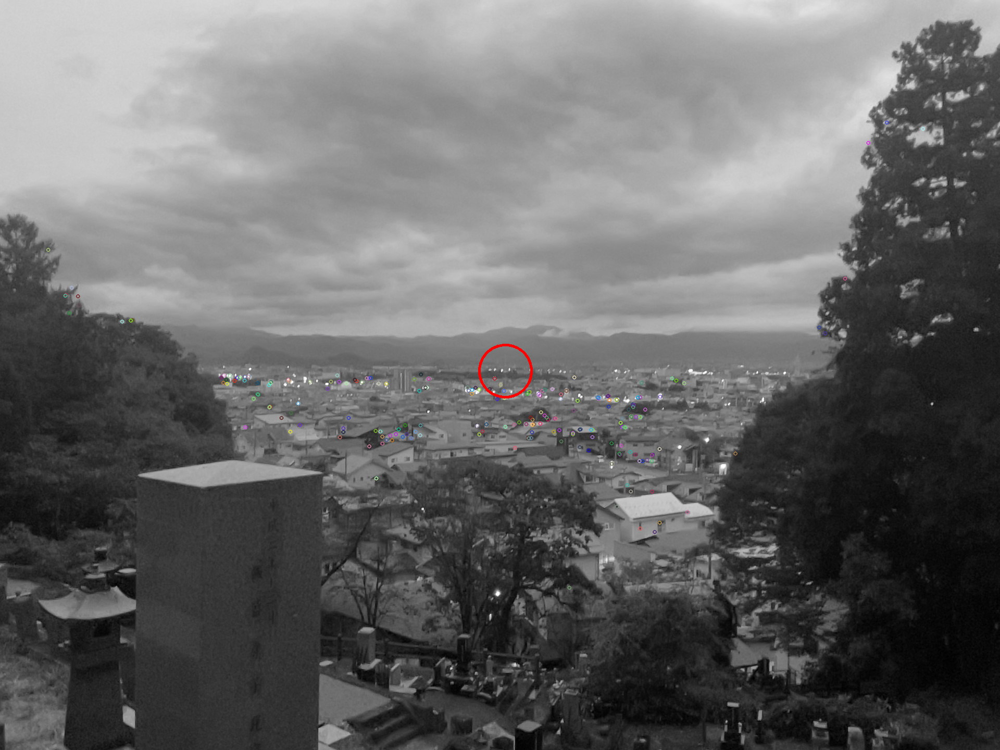

In [8]:
from google.colab.patches import cv2_imshow


def imageCoordinates(point3d, R, t, intrinsics):
  point3d = np.matmul(R, point3d) + t

  coords = np.matmul(intrinsics, point3d)
  coords = coords / coords[2]
  return (int(coords[0]), int(coords[1]))
  
# Visualize Results
tsuruga = map.anchors[0].transform[0:3,3].T

def visualize_results(img, frame, kpts, matches, R, t):
  coords = imageCoordinates(tsuruga, R, t, frame.intrinsics)
  print("tsuruga pixel coords", coords)

  good_kpts = []
  for match in matches:
    good_kpts.append(kpts[match.queryIdx])

  result = cv2.drawKeypoints(img, good_kpts, None)
  result = cv2.circle(result, coords, 50, (0, 0, 255), 4)

  cv2_imshow(result)

visualize_results(img, frame, kpts, matches, R, t)

Localizing image 0
47 inliers found
sel [25 15]
lamda1 57865.272565362975
lamda2 55199.92298526948
t1 [-8136.2865 -2051.0006 58725.7258]
t2 [-8136.2242 -2043.9205 58725.433 ]
R [[ 0.821  -0.0096 -0.5682]
 [-0.0391 -0.9984 -0.0397]
 [ 0.5682 -0.0549  0.821 ]]
t [-8136.2554 -2047.4606 58725.5794]
test1 [735.0657 660.8847   1.    ]
test2 [740.924  665.7729   1.    ]
img_points1 [734.5851 687.3706]
img_points2 [740.5014 693.3134]
sel [23 29]
lamda1 10703.736063006872
lamda2 8328.72180001613
t1 [1875.0958 -119.9426 7753.801 ]
t2 [1869.0827 -390.5977 7759.1571]
R [[-1.7209e-01 -9.5749e-03  9.8351e-01]
 [ 5.5686e-02 -9.9845e-01  2.3416e-05]
 [-9.8351e-01 -5.4857e-02 -1.7209e-01]]
t [1872.0893 -255.2702 7756.479 ]
test1 [652.7622 675.9991   1.    ]
test2 [1.0504e+03 6.7768e+02 1.0000e+00]
img_points1 [651.0306 665.6269]
img_points2 [1049.2433  716.4055]
sel [6 9]
lamda1 5993.539290333773
lamda2 6019.9081738551795
t1 [1467.7647  -76.289  7692.4214]
t2 [1467.0131  -37.0002 7692.3099]
R [[ 0.8928

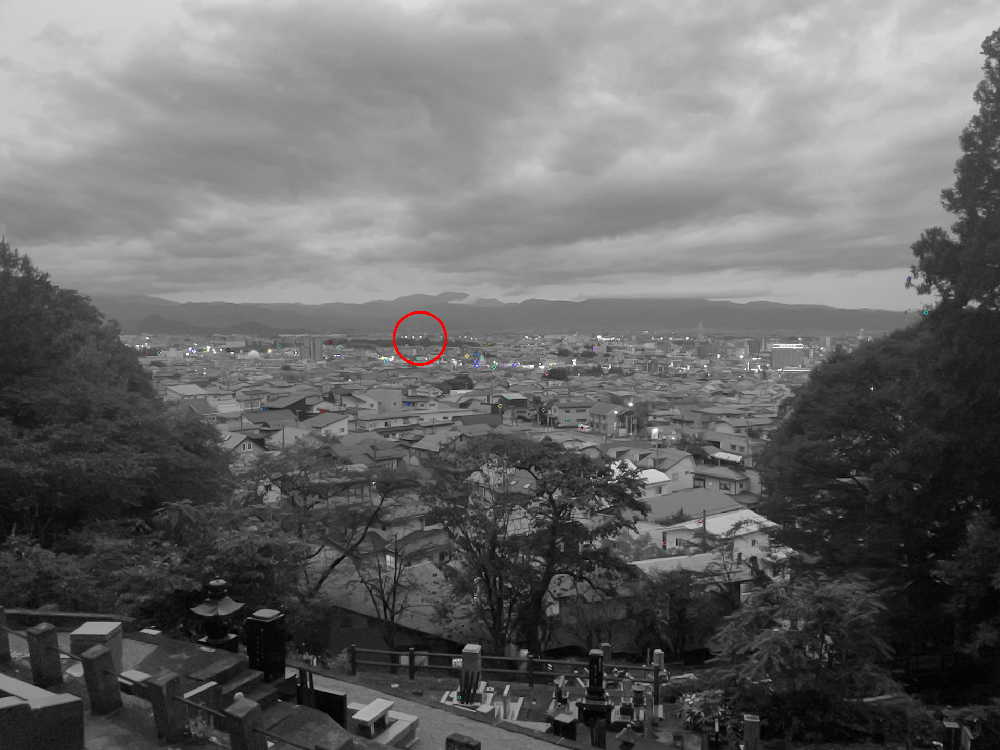

Localizing image 1
47 inliers found
sel [29  6]
lamda1 4282.956251153709
lamda2 7783.199195968892
t1 [ 276.5249 -397.2776 3983.5003]
t2 [ 278.5015 -115.9247 3977.8519]
R [[-0.7529  0.0087  0.6568]
 [ 0.0206 -0.9991  0.0369]
 [-0.6568 -0.0413 -0.7529]]
t [ 277.5132 -256.6012 3980.6761]
test1 [998.8548 625.3473   1.    ]
test2 [728.7717 646.4718   1.    ]
img_points1 [997.5797 808.8882]
img_points2 [728.8675 689.9962]
sel [23  3]
lamda1 3440.584789093858
lamda2 3428.937387208611
t1 [-1569.0841   -17.3245  6232.5281]
t2 [-1568.2155   -15.3338  6232.4312]
R [[ 0.7358  0.0087 -0.6759]
 [-0.0215 -0.9991 -0.0363]
 [ 0.6759 -0.0413  0.7358]]
t [-1568.6498   -16.3291  6232.4796]
test1 [863.8739 814.3878   1.    ]
test2 [902.561  832.9373   1.    ]
img_points1 [864.5555 704.3853]
img_points2 [903.7714 721.7904]
sel [28 15]
lamda1 7462.497183749118
lamda2 10913.325432524969
t1 [ 147.4869 -609.0029 7090.0489]
t2 [ 147.5612 -329.1469 7089.9019]
R [[-0.6361  0.0087  0.7704]
 [ 0.0263 -0.9991  0.033 

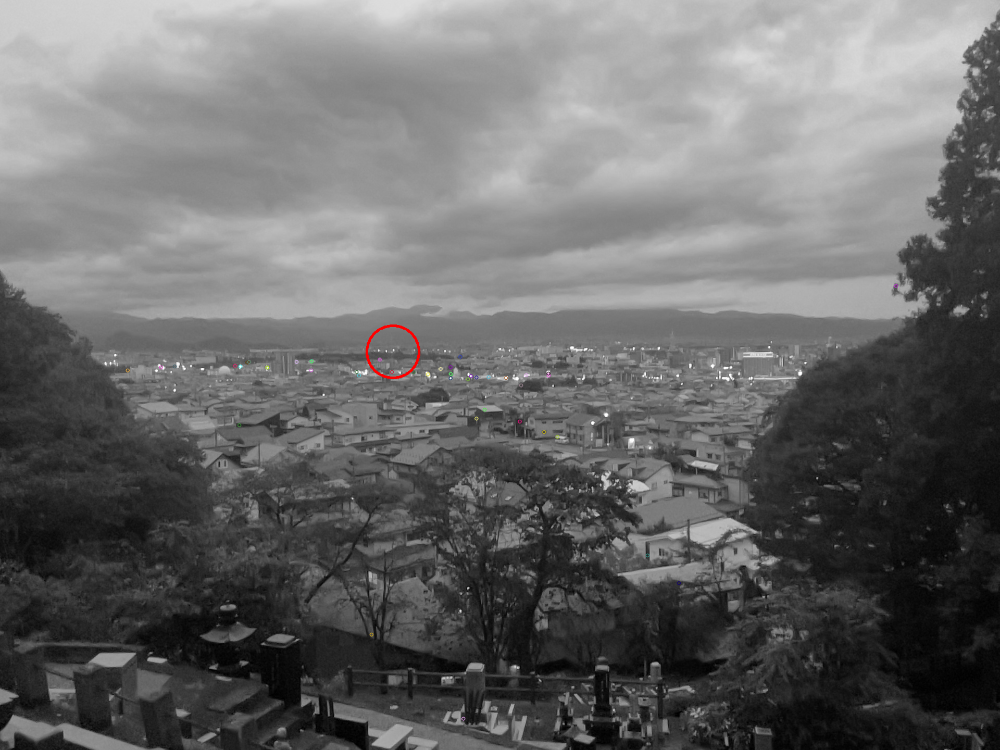

Localizing image 2
52 inliers found
sel [2 8]
lamda1 20574.531356410964
lamda2 19621.48463586834
t1 [-3518.7947  -614.1028 21515.5342]
t2 [-3518.1941  -568.8707 21514.7965]
R [[ 0.5308 -0.0193 -0.8381]
 [-0.1154 -0.9921 -0.0502]
 [ 0.8381 -0.1243  0.5308]]
t [-3518.4944  -591.4868 21515.1653]
test1 [741.0445 681.7874   1.    ]
test2 [789.4293 691.8634   1.    ]
img_points1 [736.1312 571.3784]
img_points2 [785.4861 572.8705]
sel [ 4 31]
lamda1 309.9860349265594
lamda2 349.64616426413824
t1 [-1.2070e+02 -4.8974e-01  5.6419e+02]
t2 [-121.5889   -7.4852  564.5433]
R [[ 0.7692 -0.0193 -0.6264]
 [-0.0935 -0.9921 -0.0842]
 [ 0.6264 -0.1243  0.7692]]
t [-121.1434   -3.9875  564.3691]
test1 [1.0843e+03 1.0221e+03 1.0000e+00]
test2 [655.9647 903.3118   1.    ]
img_points1 [1091.8945  699.7803]
img_points2 [647.8323 643.1811]
sel [39 22]
lamda1 966.3717818109392
lamda2 308.41991361473754
t1 [412.437    9.8997 924.2277]
t2 [412.302   17.1999 924.0693]
R [[ 0.9777 -0.0193  0.1684]
 [ 0.0021 -0.9921

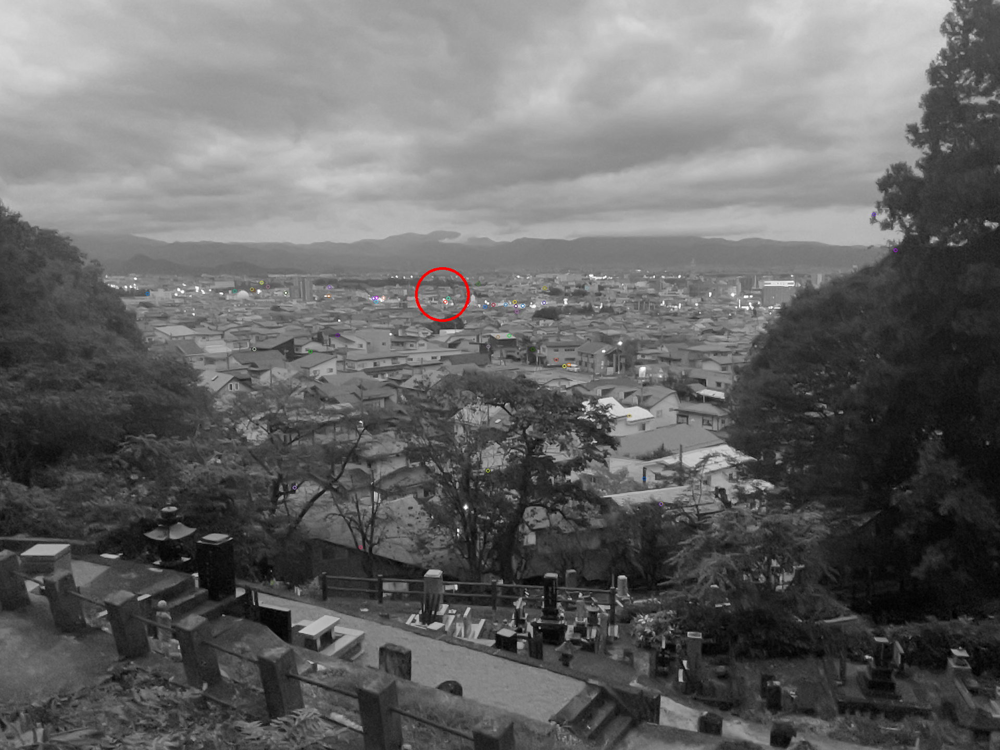

Localizing image 3
283 inliers found
sel [72 73]
lamda1 988.1369623525082
lamda2 986.9787964251835
t1 [ 400.188   -48.3061 1050.6419]
t2 [ 400.24    -49.3796 1050.6329]
R [[ 0.505  -0.0377  0.8561]
 [ 0.0695 -0.994  -0.0848]
 [-0.8561 -0.1029  0.505 ]]
t [ 400.214   -48.8428 1050.6374]
test1 [1.0786e+03 7.0914e+02 1.0000e+00]
test2 [1.0992e+03 7.0684e+02 1.0000e+00]
img_points1 [1072.7085  666.478 ]
img_points2 [1093.6416  665.8088]
sel [57 50]
lamda1 6522.995048328852
lamda2 6703.667540382343
t1 [2963.0951 -229.1986 6439.4666]
t2 [2965.8051 -146.2719 6438.4262]
R [[ 0.2544 -0.0377  0.9609]
 [ 0.0899 -0.994  -0.0628]
 [-0.9609 -0.1029  0.2544]]
t [2964.4501 -187.7352 6438.9464]
test1 [1.2479e+03 7.0585e+02 1.0000e+00]
test2 [1.0660e+03 7.0934e+02 1.0000e+00]
img_points1 [1242.6185  616.543 ]
img_points2 [1058.6117  603.9492]
sel [118 163]
lamda1 2928.218868755412
lamda2 2293.2247043435564
t1 [ 863.161    -5.4353 2243.4021]
t2 [ 856.6741 -156.3047 2247.2564]
R [[ 0.2199 -0.0377  0.9694]

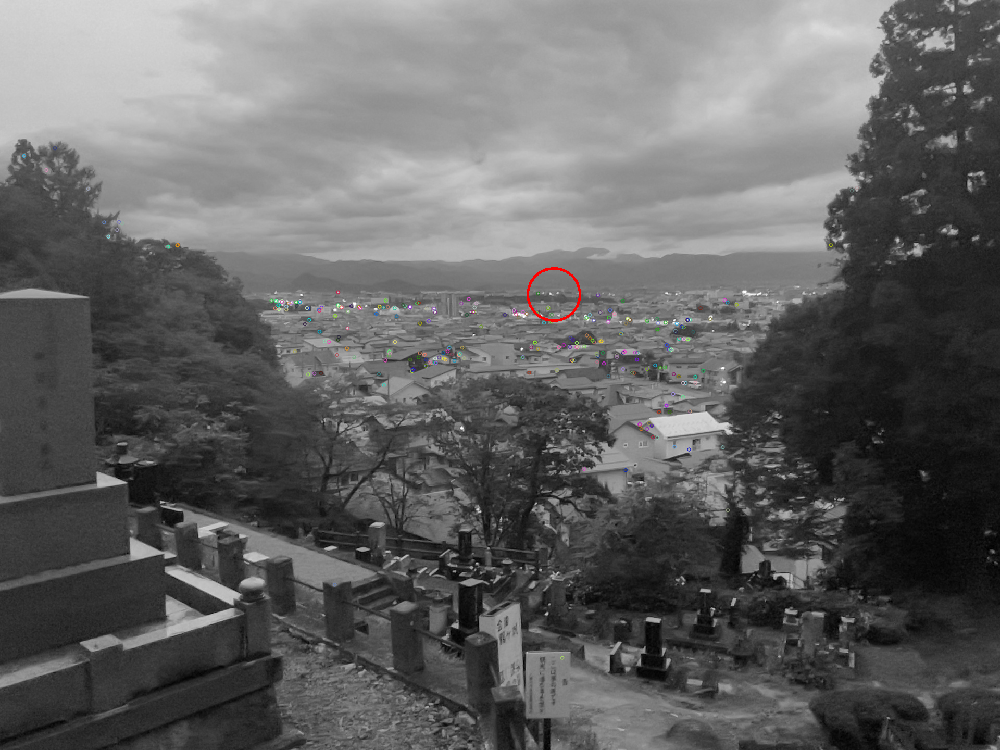

Localizing image 4
138 inliers found
sel [71 75]
lamda1 -176.45015188392853
lamda2 85.00990276294995
t1 [ 226.5877   45.3644 1215.7491]
t2 [ 226.5902   40.9436 1215.728 ]
R [[ 0.9315 -0.054  -0.3439]
 [-0.0872 -0.993  -0.0801]
 [ 0.3439 -0.1053  0.9315]]
t [ 226.589    43.154  1215.7386]
test1 [ 7.4444e+02 -1.6953e+03  1.0000e+00]
test2 [7.9645e+02 4.3067e+03 1.0000e+00]
img_points1 [786.8973 574.5662]
img_points2 [688.6885 583.1451]
sel [ 6 76]
lamda1 20204.42701774436
lamda2 18339.17917785251
t1 [  752.1229    69.0266 17897.5513]
t2 [  739.7058  -323.6652 17904.055 ]
R [[ 0.184  -0.054   0.9758]
 [ 0.0935 -0.993  -0.0726]
 [-0.9758 -0.1053  0.184 ]]
t [  745.9143  -127.3193 17900.8031]
test1 [655.4649 717.5682   1.    ]
test2 [884.7149 711.4301   1.    ]
img_points1 [641.8688 567.3259]
img_points2 [875.2017 582.6998]
sel [ 23 123]
lamda1 6771.746583291053
lamda2 7106.4084508166425
t1 [3053.5278  -79.0129 7531.6303]
t2 [3055.6981   58.0777 7531.1669]
R [[ 0.5911 -0.054   0.7979]
 [ 0.

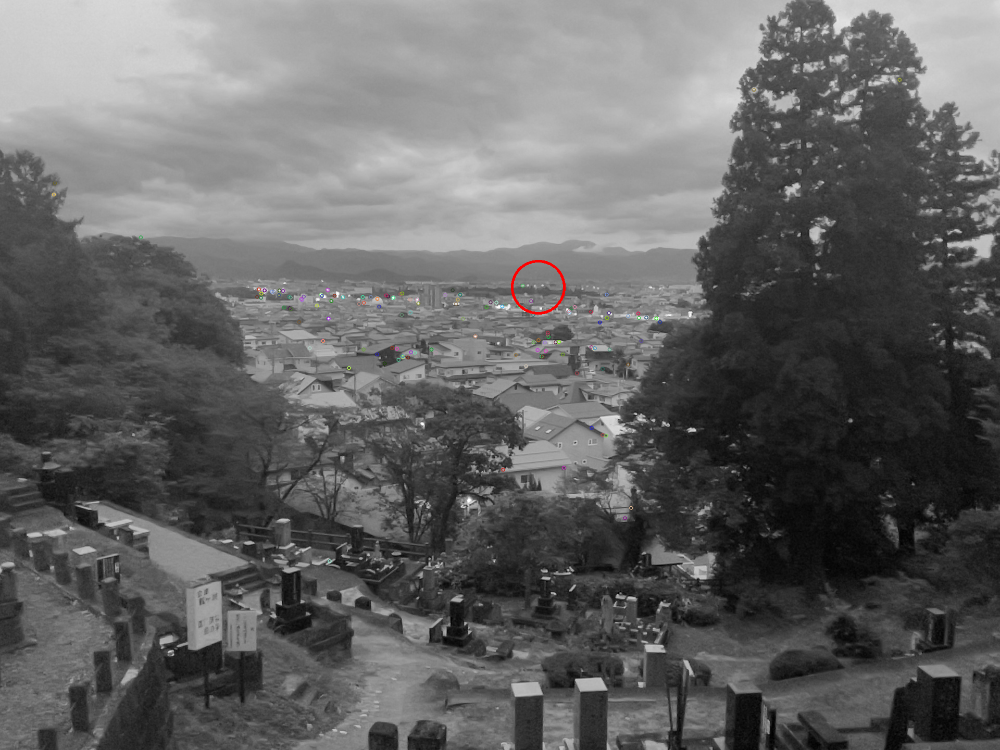

Localizing image 5
190 inliers found
sel [137  32]
lamda1 3358.617280883007
lamda2 4101.3453074899735
t1 [ 737.5    -287.6498 3191.5622]
t2 [ 755.0451  -34.4511 3173.3982]
R [[-0.1865 -0.056   0.9694]
 [ 0.1575 -0.9872 -0.0267]
 [-0.9694 -0.1497 -0.1865]]
t [ 746.2725 -161.0505 3182.4802]
test1 [1.2157e+03 6.4476e+02 1.0000e+00]
test2 [864.0371 634.1723   1.    ]
img_points1 [1205.5966  609.5489]
img_points2 [848.0883 507.3842]
sel [132  10]
lamda1 2394.0856322063
lamda2 2908.5830508295953
t1 [ 670.8096 -193.8791 2338.3466]
t2 [ 682.5265   -6.3824 2331.8008]
R [[ 0.2452 -0.056   0.9562]
 [ 0.1311 -0.9872 -0.0914]
 [-0.9562 -0.1497  0.2452]]
t [ 676.6681 -100.1307 2335.0737]
test1 [1.2574e+03 6.6911e+02 1.0000e+00]
test2 [683.4947 671.9676   1.    ]
img_points1 [1247.3726  604.1295]
img_points2 [660.376  514.6552]
sel [91 88]
lamda1 88865.37563238262
lamda2 89583.51013183458
t1 [-14715.5476  -1058.8183  87048.6002]
t2 [-14732.1949   -776.2519  87013.6446]
R [[-0.9636 -0.056   0.2144]
 [

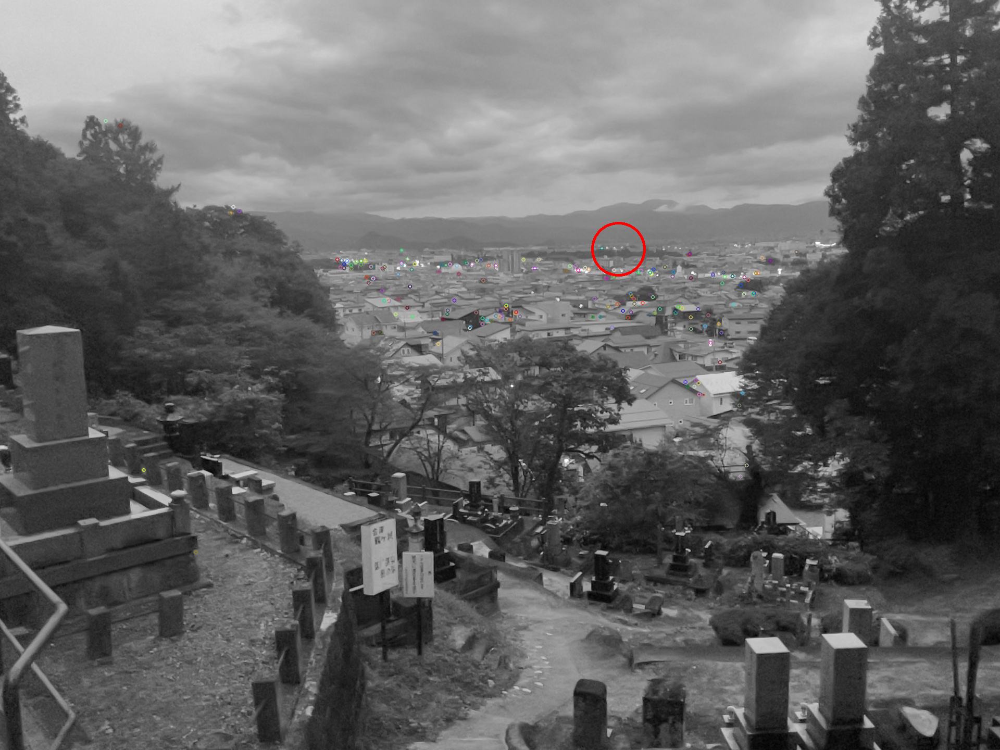

Localizing image 6
289 inliers found
sel [ 34 114]
lamda1 -1522.6958722040094
lamda2 802.7007145437365
t1 [-271.9805   86.9273  797.0201]
t2 [-271.9816   82.0503  797.1503]
R [[ 0.9631 -0.0181 -0.2568]
 [-0.0378 -0.9967 -0.0714]
 [ 0.2568 -0.0787  0.9631]]
t [-271.981    84.4888  797.0852]
test1 [1.2673e+03 3.7299e+02 1.0000e+00]
test2 [275.3317 889.5014   1.    ]
img_points1 [1265.6309  619.7053]
img_points2 [259.6863 399.1145]
sel [ 36 211]
lamda1 7271.353155300406
lamda2 3624.6363724393336
t1 [ 998.3776  -79.8996 3276.8405]
t2 [ 996.0096 -685.3305 3313.3259]
R [[-0.9021 -0.0181  0.4238]
 [ 0.0499 -0.9967  0.0635]
 [-0.4238 -0.0787 -0.9021]]
t [ 997.1936 -382.6151 3295.0832]
test1 [1.1098e+03 5.8354e+02 1.0000e+00]
test2 [1.4026e+03 5.4269e+02 1.0000e+00]
img_points1 [1108.7662  624.2393]
img_points2 [1398.8119  907.3747]
sel [152  72]
lamda1 9024.746726021629
lamda2 7839.950409995974
t1 [1806.0385 -356.399  7140.5412]
t2 [1807.9327 -550.8874 7148.6025]
R [[-0.9967 -0.0181 -0.0072]
 

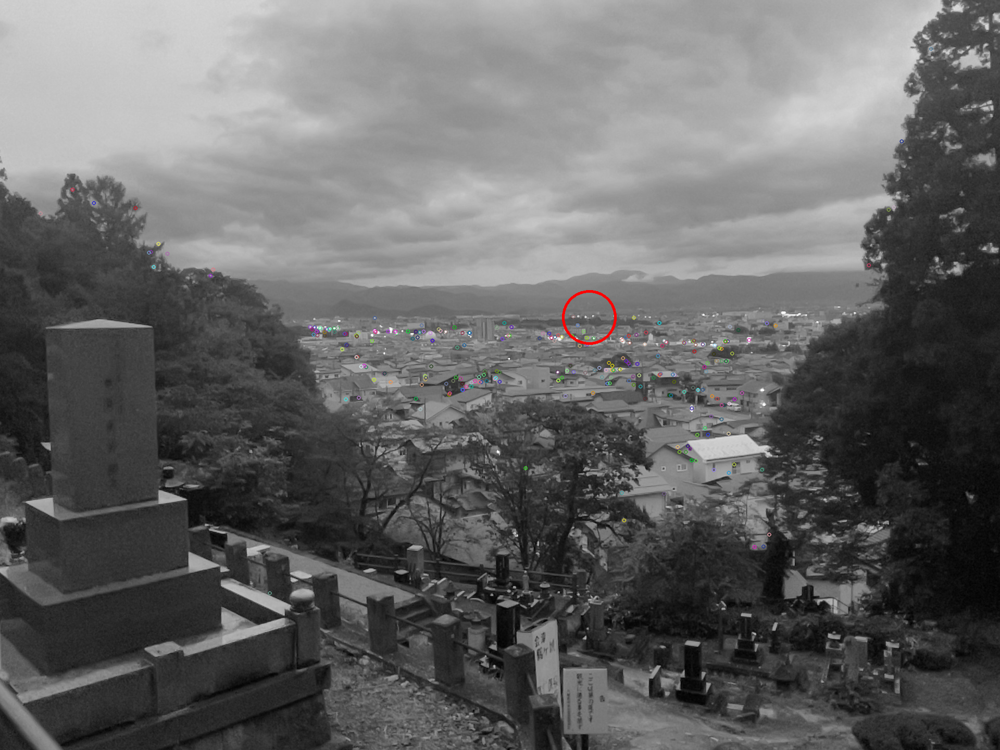

Localizing image 7
254 inliers found
sel [ 22 165]
lamda1 319.0639083452063
lamda2 326.45960839978255
t1 [ -8.185   -1.9534 615.4076]
t2 [-7.9199e+00  4.6461e-02  6.1540e+02]
R [[ 0.8698 -0.0045 -0.4854]
 [-0.0471 -0.9961 -0.0752]
 [ 0.4854 -0.0886  0.8698]]
t [ -8.0524  -0.9535 615.4015]
test1 [1.1524e+03 9.6523e+02 1.0000e+00]
test2 [1.3835e+03 1.0020e+03 1.0000e+00]
img_points1 [1154.3215  707.3657]
img_points2 [1390.5164  733.0879]
sel [61  4]
lamda1 10644.889042138831
lamda2 11753.249843594289
t1 [-1211.7484  -546.5678  9755.873 ]
t2 [-1206.4193  -372.8037  9745.2077]
R [[-0.3901 -0.0045  0.9165]
 [ 0.0833 -0.9961  0.0306]
 [-0.9165 -0.0886 -0.3901]]
t [-1209.0838  -459.6858  9750.5404]
test1 [704.5951 639.942    1.    ]
test2 [654.7787 635.0168   1.    ]
img_points1 [703.0744 662.0718]
img_points2 [652.7967 631.2355]
sel [129 144]
lamda1 5699.158589704251
lamda2 4863.199275062612
t1 [-145.0078 -228.7095 4550.2202]
t2 [-146.6756 -368.791  4558.0467]
R [[-0.7043 -0.0045  0.7043]
 [

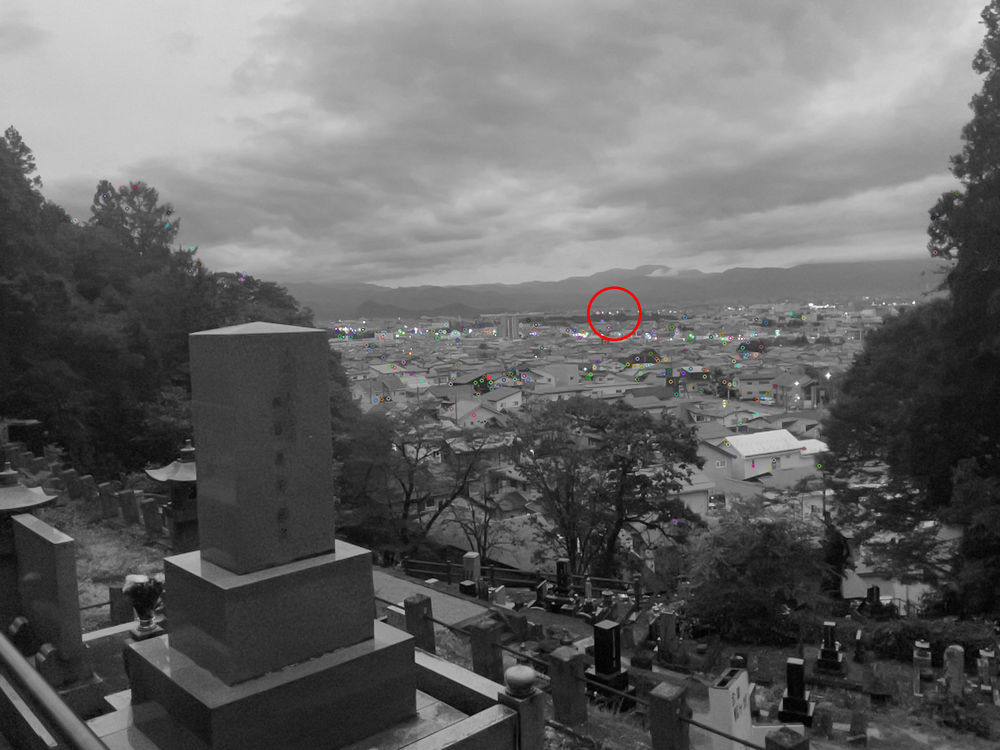

Localizing image 8
223 inliers found
sel [186  25]
lamda1 153.12521762986648
lamda2 297.3591739072069
t1 [-118.4405   10.8826  393.1139]
t2 [-118.6631    8.9698  393.3133]
R [[ 0.7327 -0.0094 -0.6804]
 [-0.0162 -0.9999 -0.0036]
 [ 0.6804 -0.0137  0.7327]]
t [-118.5518    9.9262  393.2136]
test1 [1.1122e+03 1.0864e+03 1.0000e+00]
test2 [255.1795 749.9336   1.    ]
img_points1 [1112.5563  824.3191]
img_points2 [253.6962 614.2343]
sel [181 166]
lamda1 1098.1183508474016
lamda2 2627.812957433575
t1 [226.4784 -46.0928 716.5205]
t2 [226.5498  -2.5231 716.162 ]
R [[-0.7689 -0.0094  0.6391]
 [ 0.016  -0.9999  0.0045]
 [-0.6391 -0.0137 -0.7689]]
t [226.5141 -24.308  716.3413]
test1 [1.0489e+03 7.1615e+02 1.0000e+00]
test2 [808.0842 709.3909   1.    ]
img_points1 [1049.2031  801.299 ]
img_points2 [807.8705 718.4755]
sel [168  44]
lamda1 10598.367578957366
lamda2 8321.687511990282
t1 [-2393.9072  -180.4787 11856.6559]
t2 [-2393.1881  -153.3615 11855.657 ]
R [[ 5.8978e-01 -9.4130e-03 -8.0739e-01]


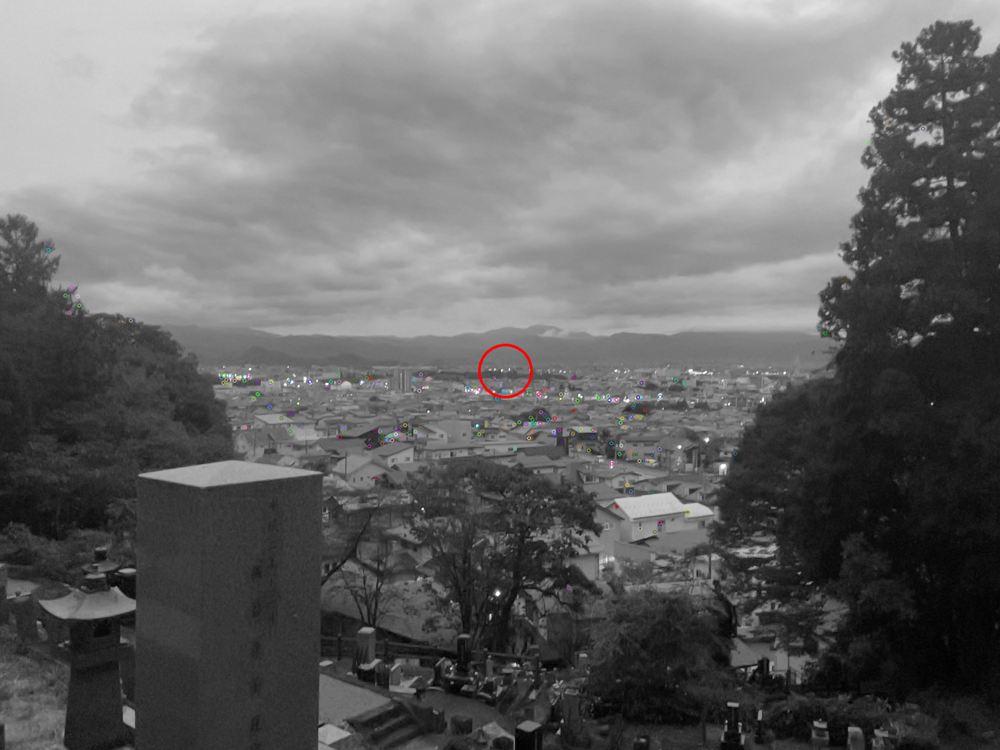

In [169]:
def localize(img_id):
  img = load_img(img_id)
  frame = frames[img_id]

  kpts, matches = feature_extract_and_match(img, map_desc)

  R, t = solve_pnp(map, kpts, matches, frame)
  visualize_results(img, frame, kpts, matches, R, t)


for i in range(len(frames)):
  print("Localizing image", i)
  localize(i)